In [51]:
import requests
from PIL import Image
from io import BytesIO

In [52]:
def download_img(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    return img

In [53]:
im1 = download_img('https://wallpapercave.com/wp/AmzdkG9.jpg')
im1.save('image.png')

In [54]:
im2 = Image.open(r"E:\residency\A1.jpg") # r is for raw string
im2.size

(1600, 1000)

In [55]:
im1.show()

In [56]:
im1.info

{'jfif': 257,
 'jfif_version': (1, 1),
 'jfif_unit': 0,
 'jfif_density': (1, 1),
 'progressive': 1,
 'progression': 1}

In [57]:
im1.mode # RGB

'RGB'

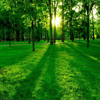

In [58]:
# resize image
im2.resize((100,100))

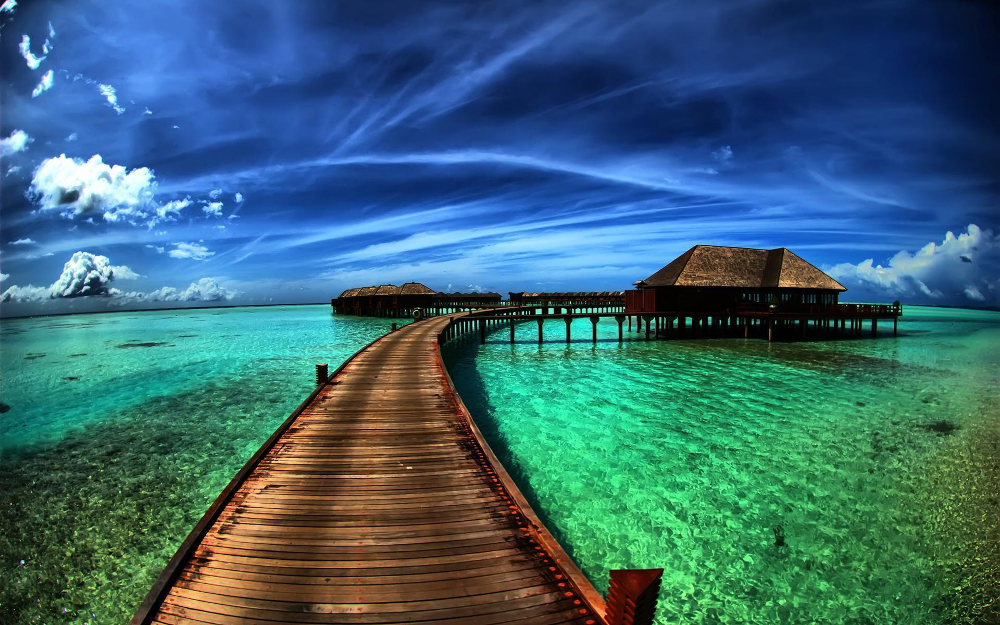

In [59]:
im1.resize(( 2* im1.width, 2* im1.height))

In [60]:
im2.resize(( im2.width//1, im2.height//1)).save('A1.jpg')

In [61]:
from PIL import ImageDraw, ImageFont

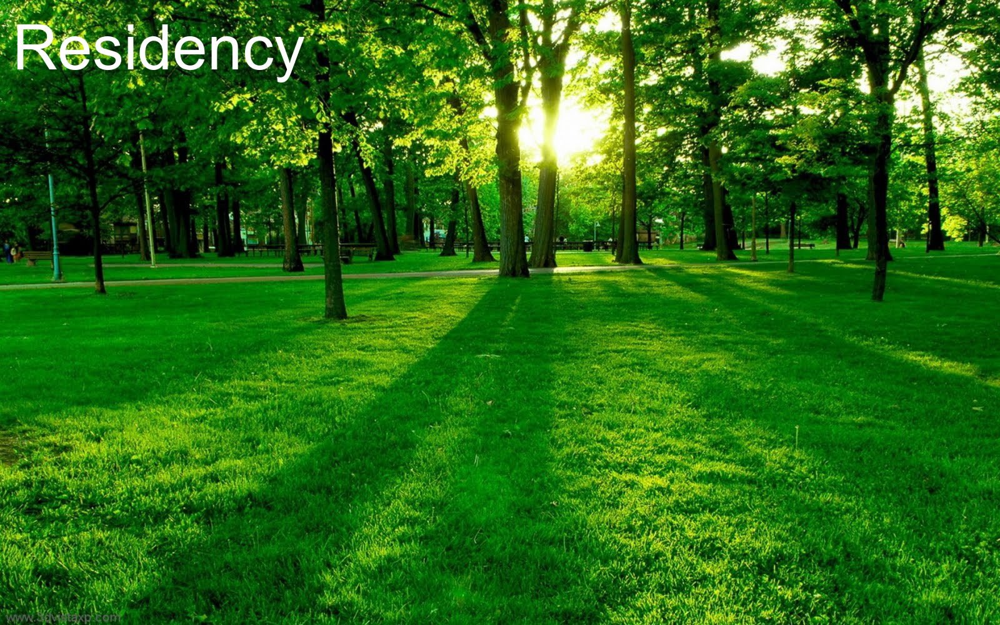

In [62]:
drawIm2 = ImageDraw.Draw(im2)
drawIm2.text((20,20), 'Residency', fill='White', font=ImageFont.truetype('arial.ttf', 100))
im2

In [63]:
im2.show()

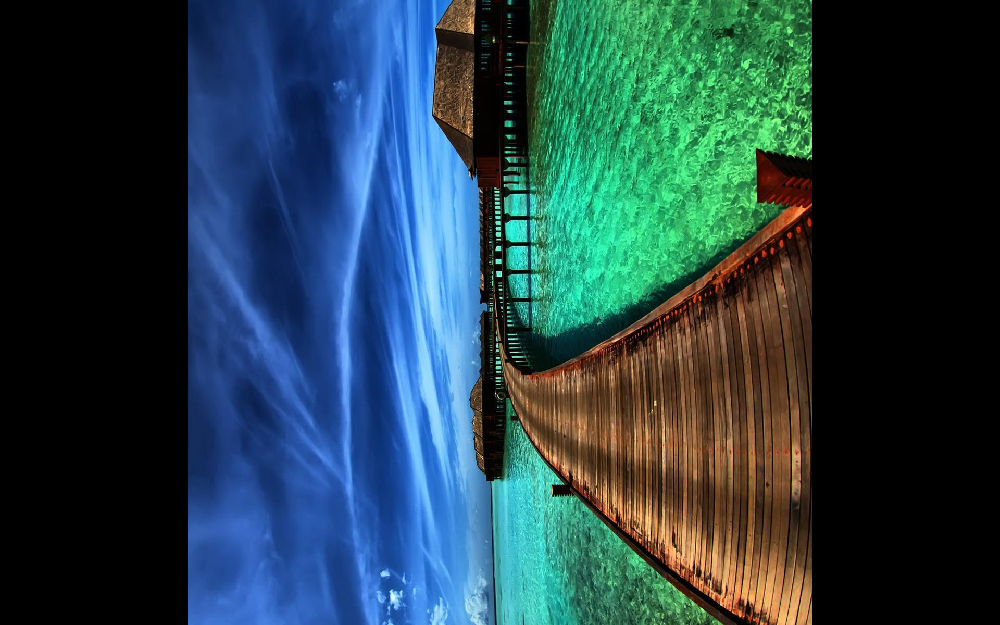

In [64]:
im1.rotate(90)

In [65]:
im2.rotate(30, expand=True, fillcolor='white').save('A1.png')

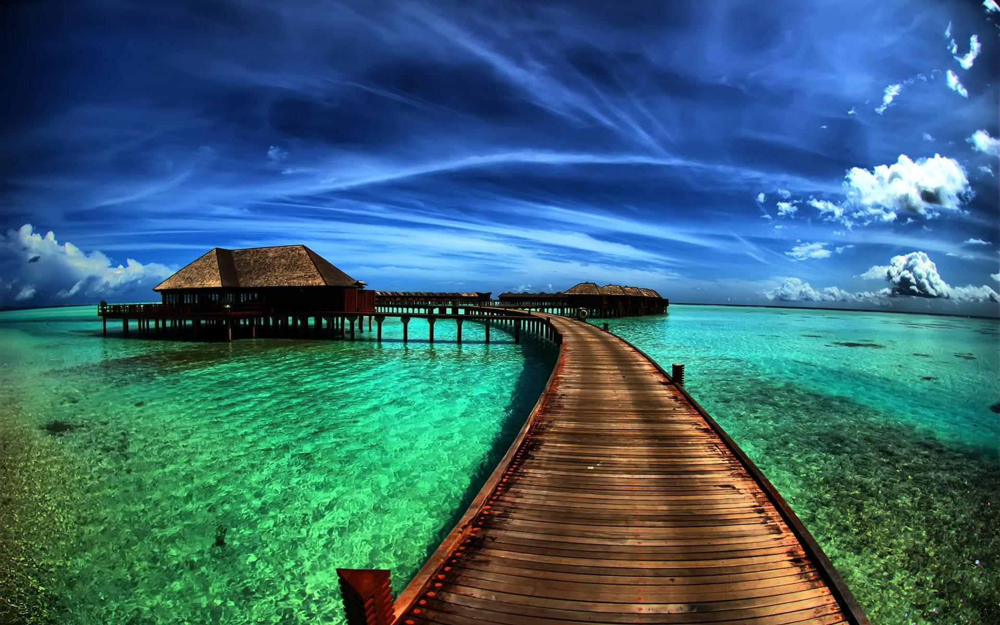

In [66]:
# IMAGE FLIP
im1.transpose(Image.Transpose.FLIP_LEFT_RIGHT)
# if u are getting error then use this
# im1.transpose(Image.FLIP_LEFT_RIGHT)

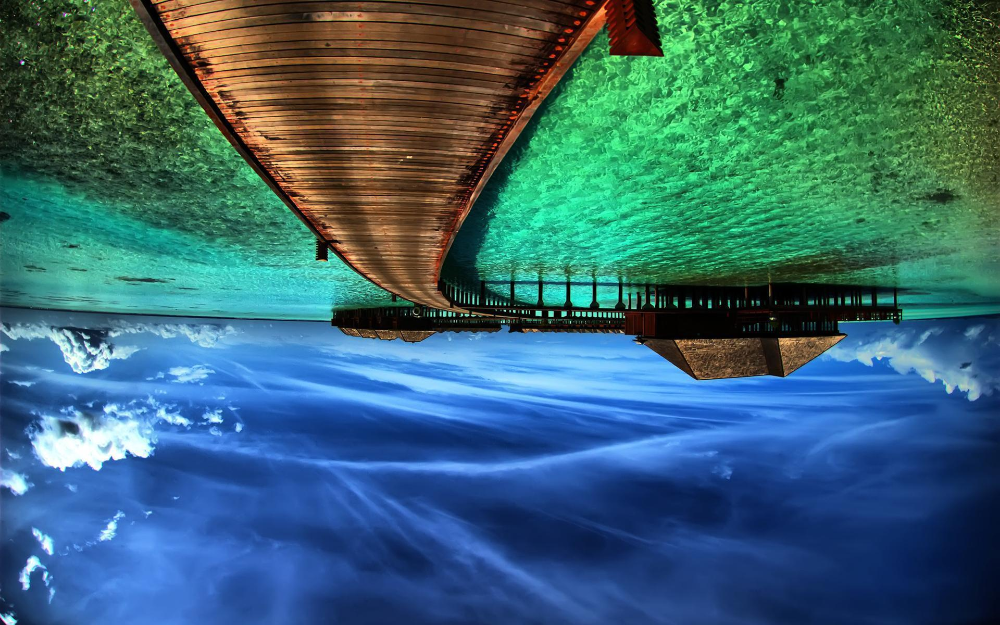

In [67]:
im1.transpose(Image.Transpose.FLIP_TOP_BOTTOM)

In [68]:
night = download_img('https://img.freepik.com/premium-photo/backgrounds-night-sky-with-stars-clouds_180633-4011.jpg?w=2000')
night.save('night.png')

In [69]:
beagle = download_img('https://i.pinimg.com/originals/15/45/45/15454595574b03548d2620a53718e402.jpg')
beagle.save('beagle.jpg')

In [70]:
print("night image resolution: ", night.size)
print('night format: ', night.format)
print("beagle image resolution: ", beagle.size)
print('beagle format: ', beagle.format)

night image resolution:  (2000, 1333)
night format:  JPEG
beagle image resolution:  (580, 812)
beagle format:  JPEG


In [71]:
def blend_image(image_1, image_2, mode='RGB', size=(100,100), alpha=0.5):
    image_1 = image_1.resize(size)
    image_2 = image_2.resize(size)
    image_1 = image_1.convert(mode)
    image_2 = image_2.convert(mode)
    blended_image = Image.blend(image_1, image_2, alpha)
    return blended_image

In [72]:
blend_image(im2, im1, alpha=0.4, size=(1000,1000)).show()

In [87]:
icon = Image.open(r'C:\Users\user\OneDrive\Documents\digipodium classes\images\PNG\Round\dog.png')

In [88]:
icon.size

(129, 157)

In [89]:
im1 = im1.convert('RGBA')
im1.paste(icon, (0,0))
im1.show()

In [93]:
def add_watermark(image, watermark, style=None, pos=(0,0)):
    image = image.convert('RGBA')                # convert image to RGBA
    watermark = watermark.convert('RGBA')        # convert watermark to RGBA
    if style == 'tile':
        for x in range(0, image.width, watermark.width):
            for y in range(0, image.height, watermark.height):
                image.paste(watermark, (x,y), mask=watermark)
    elif style is None:
        image.paste(watermark, pos, mask=watermark)
    return image

In [96]:
add_watermark(night, icon, pos=(im2.width-200,im1.height-200)).show()

In [97]:
from PIL import ImageFilter

In [102]:
filters = [
    ImageFilter.BLUR,
    ImageFilter.CONTOUR,
    ImageFilter.DETAIL,
    ImageFilter.EDGE_ENHANCE,
    ImageFilter.EMBOSS,
    ImageFilter.FIND_EDGES,
    ImageFilter.SMOOTH,
    ImageFilter.MaxFilter(7),
    ImageFilter.MinFilter(7),
    ImageFilter.MedianFilter(3),
    ImageFilter.ModeFilter(3),
    ImageFilter.GaussianBlur(30),
    ImageFilter.RankFilter(3, 3),
]
for i,filter in enumerate(filters):
    beagle.filter(filter).save(f'beagle_{i}.png')